<a href="https://colab.research.google.com/github/sathwika66/Credit-card-Fraud-Detection/blob/main/Credit_Card_Fraud_Detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [3]:
import pandas as pd
from collections import Counter
import itertools
import numpy as np # linear algebra
import matplotlib.pyplot as plt # data visualization
import seaborn as sns # statistical data visualization
!pip install --upgrade chart-studio

In [4]:
data = pd.read_csv('/content/creditcard.csv')

In [5]:
data.head()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,...,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
1,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,...,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0
2,1.0,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,...,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0
3,1.0,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,...,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0
4,2.0,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,...,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0


In [6]:
data.describe()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
count,284807.000000,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,...,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,284807.000000,284807.000000
mean,94813.859575,1.168375e-15,3.416908e-16,-1.379537e-15,2.074095e-15,9.604066e-16,1.487313e-15,-5.556467e-16,1.213481e-16,-2.406331e-15,...,1.654067e-16,-3.568593e-16,2.578648e-16,4.473266e-15,5.340915e-16,1.683437e-15,-3.660091e-16,-1.227390e-16,88.349619,0.001727
std,47488.145955,1.958696e+00,1.651309e+00,1.516255e+00,1.415869e+00,1.380247e+00,1.332271e+00,1.237094e+00,1.194353e+00,1.098632e+00,...,7.345240e-01,7.257016e-01,6.244603e-01,6.056471e-01,5.212781e-01,4.822270e-01,4.036325e-01,3.300833e-01,250.120109,0.041527
min,0.000000,-5.640751e+01,-7.271573e+01,-4.832559e+01,-5.683171e+00,-1.137433e+02,-2.616051e+01,-4.355724e+01,-7.321672e+01,-1.343407e+01,...,-3.483038e+01,-1.093314e+01,-4.480774e+01,-2.836627e+00,-1.029540e+01,-2.604551e+00,-2.256568e+01,-1.543008e+01,0.000000,0.000000
25%,54201.500000,-9.203734e-01,-5.985499e-01,-8.903648e-01,-8.486401e-01,-6.915971e-01,-7.682956e-01,-5.540759e-01,-2.086297e-01,-6.430976e-01,...,-2.283949e-01,-5.423504e-01,-1.618463e-01,-3.545861e-01,-3.171451e-01,-3.269839e-01,-7.083953e-02,-5.295979e-02,5.600000,0.000000
50%,84692.000000,1.810880e-02,6.548556e-02,1.798463e-01,-1.984653e-02,-5.433583e-02,-2.741871e-01,4.010308e-02,2.235804e-02,-5.142873e-02,...,-2.945017e-02,6.781943e-03,-1.119293e-02,4.097606e-02,1.659350e-02,-5.213911e-02,1.342146e-03,1.124383e-02,22.000000,0.000000
75%,139320.500000,1.315642e+00,8.037239e-01,1.027196e+00,7.433413e-01,6.119264e-01,3.985649e-01,5.704361e-01,3.273459e-01,5.971390e-01,...,1.863772e-01,5.285536e-01,1.476421e-01,4.395266e-01,3.507156e-01,2.409522e-01,9.104512e-02,7.827995e-02,77.165000,0.000000
max,172792.000000,2.454930e+00,2.205773e+01,9.382558e+00,1.687534e+01,3.480167e+01,7.330163e+01,1.205895e+02,2.000721e+01,1.559499e+01,...,2.720284e+01,1.050309e+01,2.252841e+01,4.584549e+00,7.519589e+00,3.517346e+00,3.161220e+01,3.384781e+01,25691.160000,1.000000


In [7]:
data.isnull().values.any()

np.False_

In [8]:
data["Amount"].describe()

,Amount
count,284807.000000
mean,88.349619
std,250.120109
min,0.000000
25%,5.600000
50%,22.000000
75%,77.165000
max,25691.160000


In [9]:
non_fraud = len(data[data.Class == 0])
fraud = len(data[data.Class == 1])
fraud_percent = (fraud / (fraud + non_fraud)) * 100

print("Number of Genuine transactions: ", non_fraud)
print("Number of Fraud transactions: ", fraud)
print("Percentage of Fraud transactions: {:.4f}".format(fraud_percent))

Number of Genuine transactions:  284315
Number of Fraud transactions:  492
Percentage of Fraud transactions: 0.1727


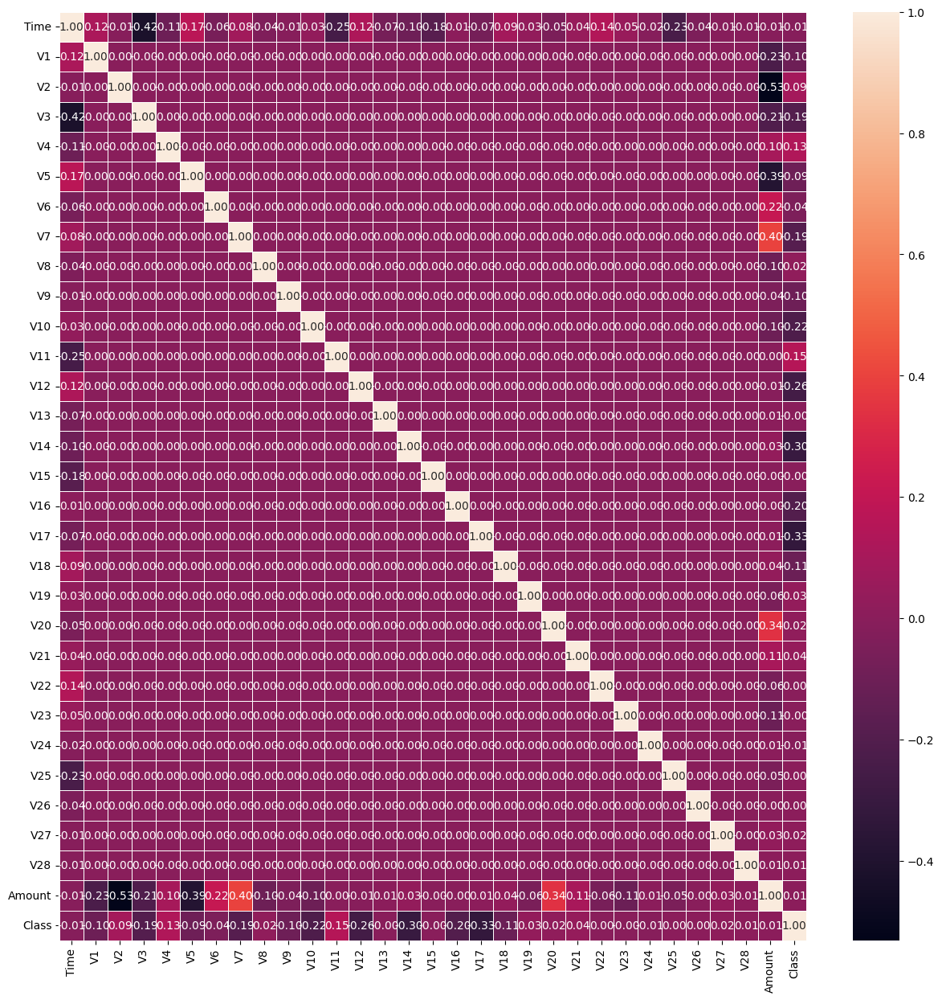

In [10]:
f,ax = plt.subplots(figsize = (15, 15))
sns.heatmap(data.corr(), annot = True, linewidths = .5, fmt = '.2f')
plt.show()

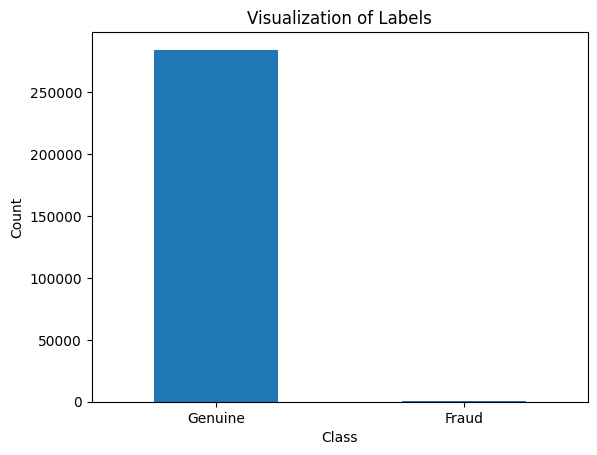

In [11]:
import matplotlib.pyplot as plt

labels = ["Genuine", "Fraud"]
count_classes = data.value_counts(data['Class'], sort= True)
count_classes.plot(kind = "bar", rot = 0)
plt.title("Visualization of Labels")
plt.ylabel("Count")
plt.xticks(range(2), labels)
plt.show()

Class as pie chart:


Text(0, 0.5, '')

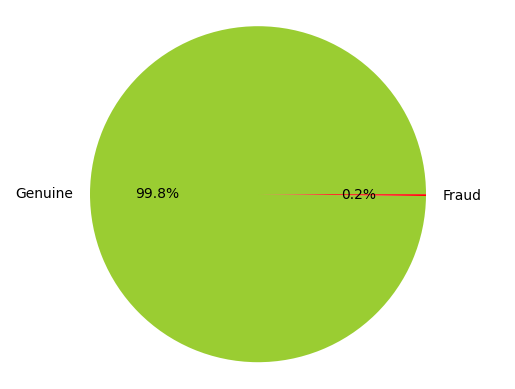

In [12]:
print("Class as pie chart:")
fig, ax = plt.subplots(1, 1)
ax.pie(data.Class.value_counts(),autopct='%1.1f%%', labels=['Genuine','Fraud'], colors=['yellowgreen','r'])
plt.axis('equal')
plt.ylabel('')

In [13]:
X = data.drop(['Class'], axis = 1)
Y = data["Class"]
print(X.shape)
print(Y.shape)
# getting just the values for the sake of processing
# (its a numpy array with no columns)
xData = X.values
yData = Y.values

(284807, 30)
(284807,)


In [14]:
import numpy as np
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
data["NormalizedAmount"] = scaler.fit_transform(data["Amount"].values.reshape(-1, 1))
data.drop(["Amount", "Time"], inplace= True, axis= 1)

Y = data["Class"]
X = data.drop(["Class"], axis= 1)

In [15]:
def enable_plotly_in_cell():
  import IPython
  from plotly.offline import init_notebook_mode
  display(IPython.core.display.HTML('''<script src="/static/components/requirejs/require.js"></script>'''))
  init_notebook_mode(connected=False)
from plotly.offline import iplot
import plotly.graph_objs as go

enable_plotly_in_cell()
trace1 = go.Box(
    x = data.V7,
    name = 'V7',
    marker = dict(color = 'blue')
    )
box_data = [trace1]
iplot(box_data)

In [16]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=0)

In [17]:
print("Shape of train_X: ", X_train.shape)
print("Shape of test_X: ", X_test.shape)

Shape of train_X:  (227845, 29)
Shape of test_X:  (56962, 29)


In [18]:
#Decision Tree Classifier
from sklearn.tree import DecisionTreeClassifier
decision_tree = DecisionTreeClassifier()

In [19]:
decision_tree.fit(X_train,y_train)
predictions_dt = decision_tree.predict(X_test)
decision_tree_score = decision_tree.score(X_test,y_test) * 100


In [20]:
from sklearn import metrics
print("Accuracy:",decision_tree_score)

Accuracy: 99.92451107756047


In [21]:
from sklearn.metrics import accuracy_score, precision_score, confusion_matrix, recall_score, f1_score


def metrics(actuals, predictions):
    print("Accuracy: {:.5f}".format(accuracy_score(actuals, predictions)))
    print("Precision: {:.5f}".format(precision_score(actuals, predictions)))
    print("Recall: {:.5f}".format(recall_score(actuals, predictions)))
    print("F1-score: {:.5f}".format(f1_score(actuals, predictions)))

In [22]:
print("Evaluation of Decision Tree Model")
print()
metrics(y_test, predictions_dt.round())

Evaluation of Decision Tree Model

Accuracy: 0.99925
Precision: 0.77885
Recall: 0.80198
F1-score: 0.79024


In [23]:
confusion_matrix_dt = confusion_matrix(y_test, predictions_dt.round())
print("Confusion Matrix - Decision Tree")
print(confusion_matrix_dt)

Confusion Matrix - Decision Tree
[[56838    23]
 [   20    81]]


In [24]:
from sklearn import metrics
print('Mean Squared Error (MSE):', metrics.mean_squared_error(y_test, predictions_dt))
print('Root Mean Squared Error (RMSE):', np.sqrt(metrics.mean_squared_error(y_test, predictions_dt)))

Mean Squared Error (MSE): 0.0007548892243952109
Root Mean Squared Error (RMSE): 0.027475247485604398


In [25]:
#Random Forest
from sklearn.ensemble import RandomForestClassifier

#Create a Gaussian Classifier
clf=RandomForestClassifier(n_estimators=100)

#Train the model using the training sets y_pred=clf.predict(X_test)
clf.fit(X_train,y_train)

y_pred=clf.predict(X_test)

In [26]:
print(y_pred)

[0 0 0 ... 0 0 0]


In [27]:
from sklearn import metrics
rdf_score=metrics.accuracy_score(y_test, y_pred)*100
print("Accuracy:",rdf_score)

Accuracy: 99.95084442259751


In [29]:
from sklearn.metrics import accuracy_score, precision_score, confusion_matrix, recall_score, f1_score


def metrics(actuals, predictions):
    print("Accuracy: {:.5f}".format(accuracy_score(actuals, predictions)))
    print("Precision: {:.5f}".format(precision_score(actuals, predictions)))
    print("Recall: {:.5f}".format(recall_score(actuals, predictions)))
    print("F1-score: {:.5f}".format(f1_score(actuals, predictions)))

In [30]:
cm_resampled = confusion_matrix(y_test, y_pred.round())
print("Confusion Matrix - Random Forest")
print(cm_resampled)

Confusion Matrix - Random Forest
[[56855     6]
 [   22    79]]


In [31]:
print("Evaluation of Random Forest Model")
print()

metrics(y_test,y_pred.round())

Evaluation of Random Forest Model

Accuracy: 0.99951
Precision: 0.92941
Recall: 0.78218
F1-score: 0.84946


In [32]:
from sklearn import metrics
print('Mean Squared Error (MSE):', metrics.mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error (RMSE):', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

Mean Squared Error (MSE): 0.0004915557740247885
Root Mean Squared Error (RMSE): 0.02217105712465665


In [33]:
#Linear Regression

In [34]:
from sklearn.linear_model import LinearRegression
model = LinearRegression()
model.fit(X_train, y_train)

LinearRegression()

In [35]:
y_pred=model.predict(X_test)
from sklearn import metrics
lr_score=metrics.r2_score(y_test, y_pred)*100
print("Accuracy:",lr_score)

Accuracy: 52.78356723880293


In [36]:
# Intercept & Coef
print("Intercept :", model.intercept_)
print("Coef :", model.coef_)

Intercept : 0.0017277527659866627
Coef : [-0.00192548  0.00283291 -0.00502303  0.00379866 -0.00233186 -0.00164645
 -0.00685855  0.00081944 -0.00358419 -0.00806366  0.00635168 -0.010848
 -0.00018994 -0.0132194  -0.00020439 -0.00928612 -0.01601663 -0.005622
  0.00187671  0.00027046  0.00214548  0.00013085  0.00021351 -0.00054779
  0.0004217   0.00048843  0.00174585  0.00131207  0.00177462]


In [37]:
# New data (real , estimated)
new_data = pd.DataFrame({'real': y_test, 'estimated': y_pred})
new_data

,real,estimated
183484,0,0.006817
255448,0,0.004612
244749,0,0.000949
63919,0,0.001299
11475,0,-0.001057
...,...,...
236778,0,-0.003144
127073,0,-0.000805
208502,0,0.001338
263323,0,0.005243


In [38]:
from sklearn import metrics
print('Mean Squared Error (MSE):', metrics.mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error (RMSE):', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

Mean Squared Error (MSE): 0.0008357157380333658
Root Mean Squared Error (RMSE): 0.028908748468817632


In [40]:
from sklearn.metrics import accuracy_score, precision_score, confusion_matrix, recall_score, f1_score


def metrics(actuals, predictions):
    print("Precision: {:.5f}".format(precision_score(actuals, predictions)))
    print("Recall: {:.5f}".format(recall_score(actuals, predictions)))
    print("F1-score: {:.5f}".format(f1_score(actuals, predictions)))

lr_resampled = confusion_matrix(y_test, y_pred.round())
print("Confusion Matrix - linear reggresion")
print(lr_resampled)

Confusion Matrix - linear reggresion
[[56854     7]
 [   55    46]]


In [41]:
print("Evaluation of linear regression Model")
print()

metrics(y_test,y_pred.round())

Evaluation of linear regression Model

Precision: 0.86792
Recall: 0.45545
F1-score: 0.59740


In [42]:
print("Logistic Regression")


Logistic Regression


In [43]:
from sklearn.linear_model import LogisticRegression

In [44]:
logistic_model = LogisticRegression()

In [45]:
data = data.reset_index(drop=True)
data.shape

(284807, 30)

In [46]:
from sklearn import model_selection

array = data.values
X = array[:,0:20]
Y = array[:,20]

# Get Training and Validation sets
X_train, X_test, Y_train, Y_test = model_selection.train_test_split(X, Y, test_size=0.2, random_state=7)

In [48]:
from sklearn.metrics import accuracy_score
from sklearn.linear_model import LogisticRegression
model = LogisticRegression()

model.fit(X_train, y_train)
predictions = model.predict(X_test)
logl_score = accuracy_score(predictions,y_test)*100

y_pred=model.predict(X_test)

In [49]:
from sklearn import metrics
logl_score=metrics.accuracy_score(y_test, y_pred)*100
print("Accuracy:",logl_score)

Accuracy: 99.82093325374811


In [50]:
from sklearn import metrics
print('Mean Squared Error (MSE):', metrics.mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error (RMSE):', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

Mean Squared Error (MSE): 0.0017906674625188723
Root Mean Squared Error (RMSE): 0.04231627893044085


In [51]:
print("kmeans clustering")
from sklearn.cluster import KMeans

kmeans clustering


In [52]:
from sklearn.model_selection import train_test_split

X_train, X_test, Y_train, Y_test = model_selection.train_test_split(X, Y, test_size=0.2, random_state=7)

kmeans=KMeans(n_clusters=2,random_state=0,algorithm="elkan",max_iter=10000)



In [53]:
kmeans.fit(X_train,Y_train)


KMeans(algorithm='elkan', max_iter=10000, n_clusters=2, random_state=0)

In [54]:
predictions = kmeans.predict(X_test)

kmeans_score = accuracy_score(predictions,y_test)*100

y_pred=kmeans.predict(X_test)

In [55]:
from sklearn import metrics
kmeans_score=metrics.accuracy_score(y_test, y_pred)*100
print("Accuracy:",kmeans_score)

Accuracy: 47.765176784523014


In [56]:
from sklearn import metrics
print('Mean Squared Error (MSE):', metrics.mean_squared_error(Y_test, y_pred))
print('Root Mean Squared Error (RMSE):', np.sqrt(metrics.mean_squared_error(Y_test, y_pred)))

Mean Squared Error (MSE): 1.0829675979354312
Root Mean Squared Error (RMSE): 1.0406572912997973


In [57]:
print("Ensemble methods : logistic regression, linear regression, random forests--averaging")

Ensemble methods : logistic regression, linear regression, random forests--averaging


In [60]:
data1 = pd.read_csv('/content/creditcard.csv')

In [61]:
YY = data1["Class"]
XX = data1.drop(["Class"], axis= 1)

In [62]:
from sklearn.ensemble import RandomForestRegressor

In [63]:
X_train, X_test, y_train, y_test = train_test_split(XX, YY, test_size=0.20)

In [64]:
model_0 = LogisticRegression()
model_1 = LinearRegression()
model_2 = RandomForestRegressor()

In [65]:
data1['Class'] = data['Class'].astype(int)
data1['V28'] = data['V28'].astype(int)
data1 = data1.astype({"Amount":'int'})
display(data1.dtypes)

,0
Time,float64
V1,float64
V2,float64
V3,float64
V4,float64
V5,float64
V6,float64
V7,float64
V8,float64
V9,float64


In [66]:
data.isnull().sum()

,0
V1,0
V2,0
V3,0
V4,0
V5,0
V6,0
V7,0
V8,0
V9,0
V10,0


In [67]:
model_0.fit(X_train,y_train)

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. OF ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



LogisticRegression()

In [68]:
model_1.fit(X_train,y_train)

LinearRegression()

In [69]:
model_2.fit(X_train,y_train)

KeyboardInterrupt: 

In [70]:
pred_0 = model_0.predict(X_test)

In [71]:
pred_1 = model_1.predict(X_test)

In [73]:
pred_final = (pred_0+pred_1)/3.0
print(pred_final)

[ 0.00015641 -0.00050655 -0.00081125 ... -0.00061599  0.00091808
  0.00012485]


In [74]:
from sklearn.metrics import mean_squared_error
print(mean_squared_error(y_test, pred_final))

0.000821214313033942


In [75]:
from sklearn.metrics import accuracy_score, precision_score, confusion_matrix, recall_score, f1_score


def metrics(actuals, predictions):
    print("Accuracy: {:.5f}".format(accuracy_score(actuals, predictions)))
    print("Precision: {:.5f}".format(precision_score(actuals, predictions)))
    print("Recall: {:.5f}".format(recall_score(actuals, predictions)))
    print("F1-score: {:.5f}".format(f1_score(actuals, predictions)))


In [76]:
print("Evaluation of Averaging")
print()
metrics(y_test, pred_final.round())

Evaluation of Averaging

Accuracy: 0.99889
Precision: 0.89796
Recall: 0.43137
F1-score: 0.58278


In [77]:
print("Bagging")

Bagging


In [78]:
from sklearn.ensemble import BaggingRegressor

In [86]:
#model = BaggingRegressor(base_estimator = RandomForestClassifier())

In [81]:
X_train, X_test, y_train, y_test = train_test_split(
    XX, YY, test_size=0.20)

In [82]:
model.fit(X_train, y_train)
pred = model.predict(X_test)

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. OF ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



In [83]:
print(mean_squared_error(y_test, pred))

0.0011937783083459147


In [84]:
from sklearn.metrics import accuracy_score, precision_score, confusion_matrix, recall_score, f1_score


def metrics(actuals, predictions):
    print("Accuracy: {:.5f}".format(accuracy_score(actuals, predictions)))
    print("Precision: {:.5f}".format(precision_score(actuals, predictions)))
    print("Recall: {:.5f}".format(recall_score(actuals, predictions)))
    print("F1-score: {:.5f}".format(f1_score(actuals, predictions)))

In [85]:
print("Evaluation of Bagging")
print()
metrics(y_test, pred.round())

Evaluation of Bagging

Accuracy: 0.99881
Precision: 0.68269
Recall: 0.66981
F1-score: 0.67619
